<h1>Model Trainer Notebook</h1>
<h3>Training the model based on data scraped from the US Census Bureau</h3>
<h2><b>IMPORTANT:</b><br><span style="color:red;">This product uses the Census Bureau Data API but is not endorsed or certified by the Census Bureau.</span></h2>

In [1]:
# Tabular Manipulation
import pandas as pd
import numpy as np

# Model training
from sklearn.linear_model import LinearRegression

#API Requests
import requests

In [2]:
raw_design_matrix = pd.read_csv('census_data/design_matrix_before_data_engineering.csv')
raw_design_matrix

,ZCTA,Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households,Estimate Computers And Internet Use Total Households With A Computer As a Percent of Estimate Computers And Internet Use Total Households,Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years,Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population,Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years,"Estimate Educational Attainment Population 25 Years And Over 9Th To 12Th Grade, No Diploma As a Percent of Estimate Educational Attainment Population 25 Years And Over",Estimate Educational Attainment Population 25 Years And Over Associate'S Degree As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over Bachelor'S Degree As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over High School Graduate (Includes Equivalency) As a Percent of Estimate Educational Attainment Population 25 Years And Over,...,STATE_TN,STATE_TX,STATE_UT,STATE_VA,STATE_VT,STATE_WA,STATE_WI,STATE_WV,STATE_WY,Bias
0,1001,0.851,0.899,0.088,0.130,0.031,0.055,0.111,0.224,0.275,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
1,1002,0.929,0.970,0.100,0.108,0.048,0.011,0.050,0.239,0.120,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
2,1005,0.918,0.930,0.086,0.093,0.059,0.005,0.081,0.188,0.308,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
3,1007,0.943,0.968,0.063,0.102,0.067,0.015,0.123,0.239,0.239,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
4,1008,0.775,0.941,0.097,0.105,0.024,0.065,0.138,0.181,0.350,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29173,99921,0.734,0.880,0.198,0.207,0.034,0.064,0.079,0.160,0.351,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
29174,99922,0.587,0.843,0.161,0.185,0.095,0.068,0.046,0.105,0.502,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
29175,99925,0.571,0.849,0.237,0.243,0.035,0.067,0.079,0.124,0.377,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
29176,99926,0.691,0.882,0.203,0.264,0.137,0.078,0.113,0.066,0.411,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1


<h3>Model Training Process</h3>
<ol>
    <li>Train a model based on broadband internet access to predict health outcomes in PLACES data + OHE state data</li>
    <li>Add in Demographic features and create a multilinear model with those incorporated</li>
    <li>Add in Economic features and create a multilinear model with those incorporated --> Built on last</li>
    <li>Add in Social features and create a multilinear model with those incorporated --> Built on last</li>
</ol>

<p>Worry about controlling out for factors that are driving the impact we are seeing</p>

In [3]:
outcomes = pd.read_csv('outcome_matrix.csv')
outcomes

,ZCTA,Diagnosed diabetes among adults aged >=18 years,Mental health not good for >=14 days among adults aged >=18 years,Stroke among adults aged >=18 years
0,1001,0.101,0.163,0.033
1,1002,0.068,0.202,0.021
2,1003,0.020,0.338,0.007
3,1005,0.083,0.162,0.027
4,1007,0.071,0.147,0.023
...,...,...,...,...
31430,99923,0.090,0.115,0.031
31431,99925,0.127,0.170,0.042
31432,99926,0.138,0.198,0.044
31433,99927,0.124,0.157,0.040


In [4]:
combined_df = outcomes.merge(raw_design_matrix, on="ZCTA")
combined_df

,ZCTA,Diagnosed diabetes among adults aged >=18 years,Mental health not good for >=14 days among adults aged >=18 years,Stroke among adults aged >=18 years,Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households,Estimate Computers And Internet Use Total Households With A Computer As a Percent of Estimate Computers And Internet Use Total Households,Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years,Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population,Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years,"Estimate Educational Attainment Population 25 Years And Over 9Th To 12Th Grade, No Diploma As a Percent of Estimate Educational Attainment Population 25 Years And Over",...,STATE_TN,STATE_TX,STATE_UT,STATE_VA,STATE_VT,STATE_WA,STATE_WI,STATE_WV,STATE_WY,Bias
0,1001,0.101,0.163,0.033,0.851,0.899,0.088,0.130,0.031,0.055,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
1,1002,0.068,0.202,0.021,0.929,0.970,0.100,0.108,0.048,0.011,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
2,1005,0.083,0.162,0.027,0.918,0.930,0.086,0.093,0.059,0.005,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
3,1007,0.071,0.147,0.023,0.943,0.968,0.063,0.102,0.067,0.015,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
4,1008,0.096,0.167,0.028,0.775,0.941,0.097,0.105,0.024,0.065,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28204,99921,0.100,0.172,0.032,0.734,0.880,0.198,0.207,0.034,0.064,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
28205,99922,0.131,0.195,0.042,0.587,0.843,0.161,0.185,0.095,0.068,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
28206,99925,0.127,0.170,0.042,0.571,0.849,0.237,0.243,0.035,0.067,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
28207,99926,0.138,0.198,0.044,0.691,0.882,0.203,0.264,0.137,0.078,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1


In [7]:
outcomes_cols = list(outcomes.columns)[1:]

In [8]:
outcomes_cols

['Diagnosed diabetes among adults aged >=18 years',
 'Mental health not good for >=14 days among adults aged >=18 years',
 'Stroke among adults aged >=18 years']

In [16]:
x_cols = [col for col in combined_df.columns if col not in outcomes_cols]

In [18]:
X = combined_df[x_cols]
y = combined_df[outcomes_cols]

In [19]:
X

,ZCTA,Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households,Estimate Computers And Internet Use Total Households With A Computer As a Percent of Estimate Computers And Internet Use Total Households,Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years,Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population,Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years,"Estimate Educational Attainment Population 25 Years And Over 9Th To 12Th Grade, No Diploma As a Percent of Estimate Educational Attainment Population 25 Years And Over",Estimate Educational Attainment Population 25 Years And Over Associate'S Degree As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over Bachelor'S Degree As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over High School Graduate (Includes Equivalency) As a Percent of Estimate Educational Attainment Population 25 Years And Over,...,STATE_TN,STATE_TX,STATE_UT,STATE_VA,STATE_VT,STATE_WA,STATE_WI,STATE_WV,STATE_WY,Bias
0,1001,0.851,0.899,0.088,0.130,0.031,0.055,0.111,0.224,0.275,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
1,1002,0.929,0.970,0.100,0.108,0.048,0.011,0.050,0.239,0.120,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
2,1005,0.918,0.930,0.086,0.093,0.059,0.005,0.081,0.188,0.308,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
3,1007,0.943,0.968,0.063,0.102,0.067,0.015,0.123,0.239,0.239,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
4,1008,0.775,0.941,0.097,0.105,0.024,0.065,0.138,0.181,0.350,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28204,99921,0.734,0.880,0.198,0.207,0.034,0.064,0.079,0.160,0.351,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
28205,99922,0.587,0.843,0.161,0.185,0.095,0.068,0.046,0.105,0.502,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
28206,99925,0.571,0.849,0.237,0.243,0.035,0.067,0.079,0.124,0.377,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
28207,99926,0.691,0.882,0.203,0.264,0.137,0.078,0.113,0.066,0.411,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1


In [20]:
y

,Diagnosed diabetes among adults aged >=18 years,Mental health not good for >=14 days among adults aged >=18 years,Stroke among adults aged >=18 years
0,0.101,0.163,0.033
1,0.068,0.202,0.021
2,0.083,0.162,0.027
3,0.071,0.147,0.023
4,0.096,0.167,0.028
...,...,...,...
28204,0.100,0.172,0.032
28205,0.131,0.195,0.042
28206,0.127,0.170,0.042
28207,0.138,0.198,0.044


In [21]:
from sklearn.model_selection import train_test_split
X_train_validation, X_test, y_train_validation, y_test = train_test_split(X, y, test_size=0.2)

In [24]:
X_train, X_validation, y_train, y_validation = train_test_split(X_train_validation, y_train_validation, test_size=0.25)
X_train

,ZCTA,Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households,Estimate Computers And Internet Use Total Households With A Computer As a Percent of Estimate Computers And Internet Use Total Households,Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years,Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population,Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years,"Estimate Educational Attainment Population 25 Years And Over 9Th To 12Th Grade, No Diploma As a Percent of Estimate Educational Attainment Population 25 Years And Over",Estimate Educational Attainment Population 25 Years And Over Associate'S Degree As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over Bachelor'S Degree As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over High School Graduate (Includes Equivalency) As a Percent of Estimate Educational Attainment Population 25 Years And Over,...,STATE_TN,STATE_TX,STATE_UT,STATE_VA,STATE_VT,STATE_WA,STATE_WI,STATE_WV,STATE_WY,Bias
5441,20106,0.896,0.955,0.190,0.163,0.067,0.049,0.079,0.158,0.360,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1
20584,70083,0.788,0.834,0.181,0.169,0.000,0.127,0.020,0.024,0.354,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
4946,18221,0.651,0.651,0.271,0.254,0.000,0.000,0.055,0.092,0.819,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
27441,97735,0.262,1.000,0.000,0.030,0.000,0.110,0.000,0.136,0.508,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
10852,42170,0.826,0.909,0.216,0.217,0.010,0.107,0.119,0.047,0.400,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21139,72046,0.712,0.826,0.204,0.227,0.049,0.076,0.043,0.114,0.433,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
21157,72076,0.796,0.919,0.181,0.204,0.098,0.063,0.098,0.136,0.353,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
16019,56340,0.790,0.868,0.055,0.089,0.017,0.034,0.142,0.130,0.409,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
2258,10035,0.699,0.737,0.145,0.168,0.057,0.135,0.055,0.173,0.257,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1


In [25]:
y_train

,Diagnosed diabetes among adults aged >=18 years,Mental health not good for >=14 days among adults aged >=18 years,Stroke among adults aged >=18 years
5441,0.101,0.144,0.029
20584,0.185,0.215,0.052
4946,0.125,0.158,0.040
27441,0.148,0.165,0.048
10852,0.114,0.162,0.033
...,...,...,...
21139,0.144,0.194,0.045
21157,0.115,0.193,0.034
16019,0.085,0.144,0.027
2258,0.158,0.201,0.042


In [26]:
y_train.index = X_train["ZCTA"]
X_train.set_index("ZCTA", inplace=True)
y_train

,Diagnosed diabetes among adults aged >=18 years,Mental health not good for >=14 days among adults aged >=18 years,Stroke among adults aged >=18 years
ZCTA,,,
20106,0.101,0.144,0.029
70083,0.185,0.215,0.052
18221,0.125,0.158,0.040
97735,0.148,0.165,0.048
42170,0.114,0.162,0.033
...,...,...,...
72046,0.144,0.194,0.045
72076,0.115,0.193,0.034
56340,0.085,0.144,0.027


In [27]:
X_train

,Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households,Estimate Computers And Internet Use Total Households With A Computer As a Percent of Estimate Computers And Internet Use Total Households,Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years,Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population,Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years,"Estimate Educational Attainment Population 25 Years And Over 9Th To 12Th Grade, No Diploma As a Percent of Estimate Educational Attainment Population 25 Years And Over",Estimate Educational Attainment Population 25 Years And Over Associate'S Degree As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over Bachelor'S Degree As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over High School Graduate (Includes Equivalency) As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over Less Than 9Th Grade As a Percent of Estimate Educational Attainment Population 25 Years And Over,...,STATE_TN,STATE_TX,STATE_UT,STATE_VA,STATE_VT,STATE_WA,STATE_WI,STATE_WV,STATE_WY,Bias
ZCTA,,,,,,,,,,,,,,,,,,,,,
20106,0.896,0.955,0.190,0.163,0.067,0.049,0.079,0.158,0.360,0.028,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1
70083,0.788,0.834,0.181,0.169,0.000,0.127,0.020,0.024,0.354,0.195,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
18221,0.651,0.651,0.271,0.254,0.000,0.000,0.055,0.092,0.819,0.000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
97735,0.262,1.000,0.000,0.030,0.000,0.110,0.000,0.136,0.508,0.000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
42170,0.826,0.909,0.216,0.217,0.010,0.107,0.119,0.047,0.400,0.088,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72046,0.712,0.826,0.204,0.227,0.049,0.076,0.043,0.114,0.433,0.072,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
72076,0.796,0.919,0.181,0.204,0.098,0.063,0.098,0.136,0.353,0.029,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
56340,0.790,0.868,0.055,0.089,0.017,0.034,0.142,0.130,0.409,0.013,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1


<h2>Start Training the Model</h2>

In [28]:
X_train = X_train.drop(columns=["STATE_WY"])
X_train

,Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households,Estimate Computers And Internet Use Total Households With A Computer As a Percent of Estimate Computers And Internet Use Total Households,Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population 18 To 64 Years,Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Total Civilian Noninstitutionalized Population,Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years With A Disability As a Percent of Estimate Disability Status Of The Civilian Noninstitutionalized Population Under 18 Years,"Estimate Educational Attainment Population 25 Years And Over 9Th To 12Th Grade, No Diploma As a Percent of Estimate Educational Attainment Population 25 Years And Over",Estimate Educational Attainment Population 25 Years And Over Associate'S Degree As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over Bachelor'S Degree As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over High School Graduate (Includes Equivalency) As a Percent of Estimate Educational Attainment Population 25 Years And Over,Estimate Educational Attainment Population 25 Years And Over Less Than 9Th Grade As a Percent of Estimate Educational Attainment Population 25 Years And Over,...,STATE_SD,STATE_TN,STATE_TX,STATE_UT,STATE_VA,STATE_VT,STATE_WA,STATE_WI,STATE_WV,Bias
ZCTA,,,,,,,,,,,,,,,,,,,,,
20106,0.896,0.955,0.190,0.163,0.067,0.049,0.079,0.158,0.360,0.028,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1
70083,0.788,0.834,0.181,0.169,0.000,0.127,0.020,0.024,0.354,0.195,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
18221,0.651,0.651,0.271,0.254,0.000,0.000,0.055,0.092,0.819,0.000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
97735,0.262,1.000,0.000,0.030,0.000,0.110,0.000,0.136,0.508,0.000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
42170,0.826,0.909,0.216,0.217,0.010,0.107,0.119,0.047,0.400,0.088,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72046,0.712,0.826,0.204,0.227,0.049,0.076,0.043,0.114,0.433,0.072,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
72076,0.796,0.919,0.181,0.204,0.098,0.063,0.098,0.136,0.353,0.029,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
56340,0.790,0.868,0.055,0.089,0.017,0.034,0.142,0.130,0.409,0.013,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1


In [29]:
X_train_features = X_train.columns
initial_model_features = [col for col in X_train_features if col.startswith("STATE_") or col == "Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households" or col == "Bias"]
initial_model_features

['Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households',
 'STATE_AK',
 'STATE_AL',
 'STATE_AR',
 'STATE_AZ',
 'STATE_CA',
 'STATE_CO',
 'STATE_CT',
 'STATE_DC',
 'STATE_DE',
 'STATE_FL',
 'STATE_GA',
 'STATE_HI',
 'STATE_IA',
 'STATE_ID',
 'STATE_IL',
 'STATE_IN',
 'STATE_KS',
 'STATE_KY',
 'STATE_LA',
 'STATE_MA',
 'STATE_MD',
 'STATE_ME',
 'STATE_MI',
 'STATE_MN',
 'STATE_MO',
 'STATE_MS',
 'STATE_MT',
 'STATE_NC',
 'STATE_ND',
 'STATE_NE',
 'STATE_NH',
 'STATE_NJ',
 'STATE_NM',
 'STATE_NV',
 'STATE_NY',
 'STATE_OH',
 'STATE_OK',
 'STATE_OR',
 'STATE_PA',
 'STATE_RI',
 'STATE_SC',
 'STATE_SD',
 'STATE_TN',
 'STATE_TX',
 'STATE_UT',
 'STATE_VA',
 'STATE_VT',
 'STATE_WA',
 'STATE_WI',
 'STATE_WV',
 'Bias']

In [30]:
X_train_initial = X_train[initial_model_features]
X_train_initial

,Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households,STATE_AK,STATE_AL,STATE_AR,STATE_AZ,STATE_CA,STATE_CO,STATE_CT,STATE_DC,STATE_DE,...,STATE_SD,STATE_TN,STATE_TX,STATE_UT,STATE_VA,STATE_VT,STATE_WA,STATE_WI,STATE_WV,Bias
ZCTA,,,,,,,,,,,,,,,,,,,,,
20106,0.896,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1
70083,0.788,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
18221,0.651,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
97735,0.262,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
42170,0.826,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72046,0.712,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
72076,0.796,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
56340,0.790,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1


In [31]:
import plotly.express as px
import seaborn as sns

In [32]:
import matplotlib.pyplot as plt

Text(0.5, 1.0, 'Internet vs Diabetes')

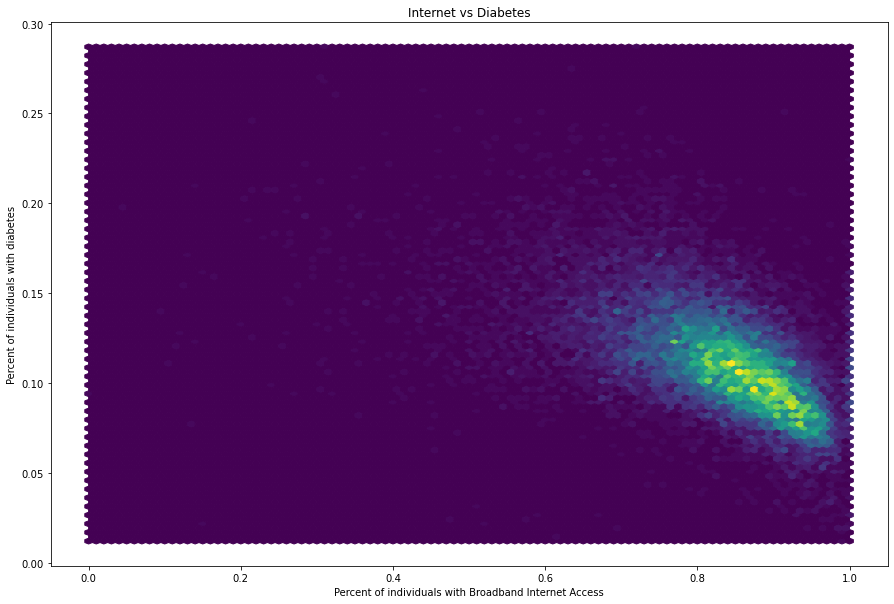

In [40]:
plt.figure(figsize=(15, 10))
plt.hexbin(x=X_train_initial.iloc[:, 0], y=y_train.iloc[:, 0])
plt.xlabel("Percent of individuals with Broadband Internet Access")
plt.ylabel("Percent of individuals with diabetes")
plt.title("Internet vs Diabetes")

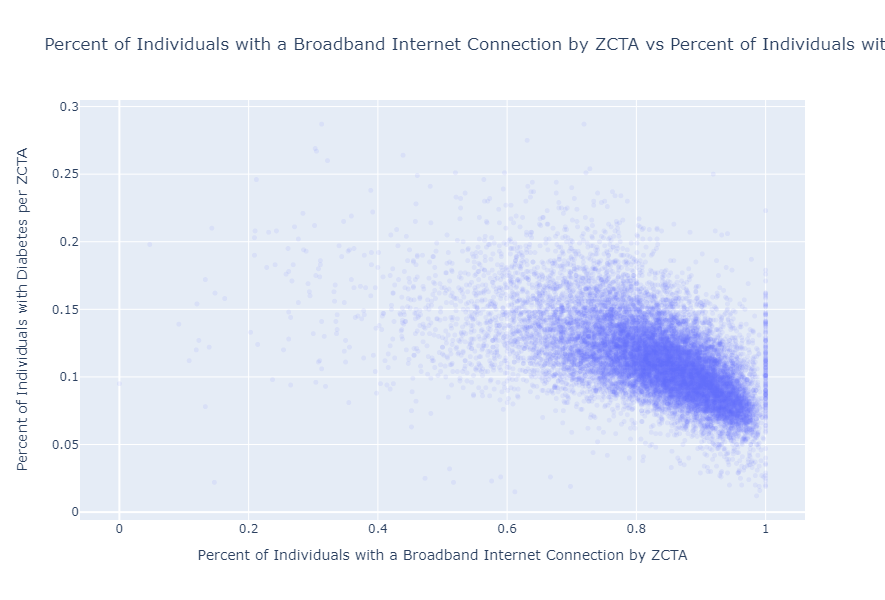

In [43]:
test_fig = px.scatter(
        x=X_train_initial.iloc[:, 0],
        y=y_train.iloc[:, 0],
        title="Percent of Individuals with a Broadband Internet Connection by ZCTA vs Percent of Individuals with Diabetes ",
       )

test_fig.update_traces(marker=dict(size=5, opacity=0.1))
test_fig.update_layout(height=600)
test_fig.update_yaxes(title_text="Percent of Individuals with Diabetes per ZCTA")
test_fig.update_xaxes(title_text="Percent of Individuals with a Broadband Internet Connection by ZCTA")
test_fig.show()

In [61]:
def get_plot(x_idx, y_idx, X_df, y_df, transformation=lambda x: x):
    x_feature = X_df.columns[x_idx]
    y_feature = y_df.columns[y_idx]
    test_fig = px.scatter(
        x=transformation(X_df.iloc[:, x_idx]),
        y=y_df.iloc[:, y_idx],
        title = f"{x_feature} vs {y_feature}",
        trendline="ols"
       )

    test_fig.update_traces(marker=dict(size=5, opacity=0.1))
    test_fig.update_layout(height=600)
    test_fig.update_yaxes(title_text=y_feature)
    test_fig.update_xaxes(title_text=x_feature)
    test_fig.show()

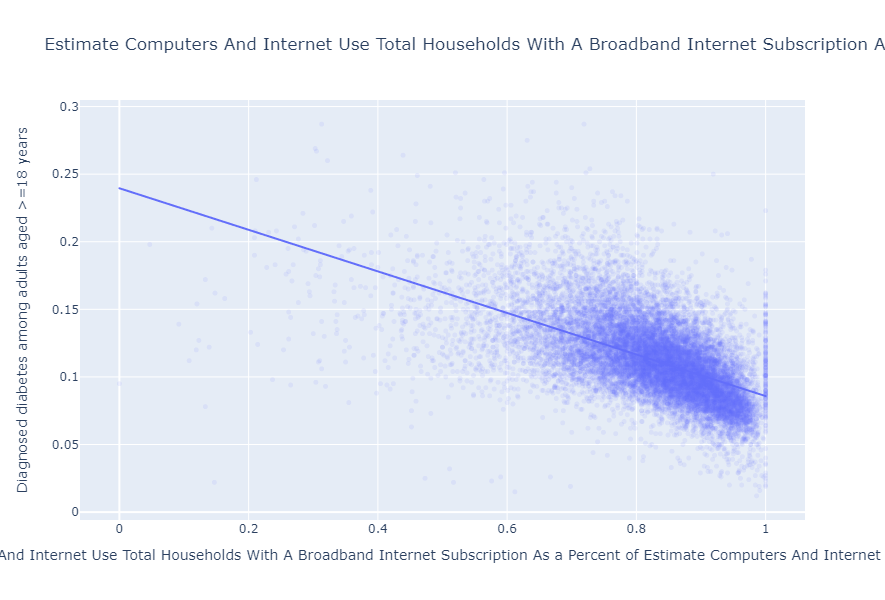

In [62]:
get_plot(0, 0, X_train_initial, y_train)

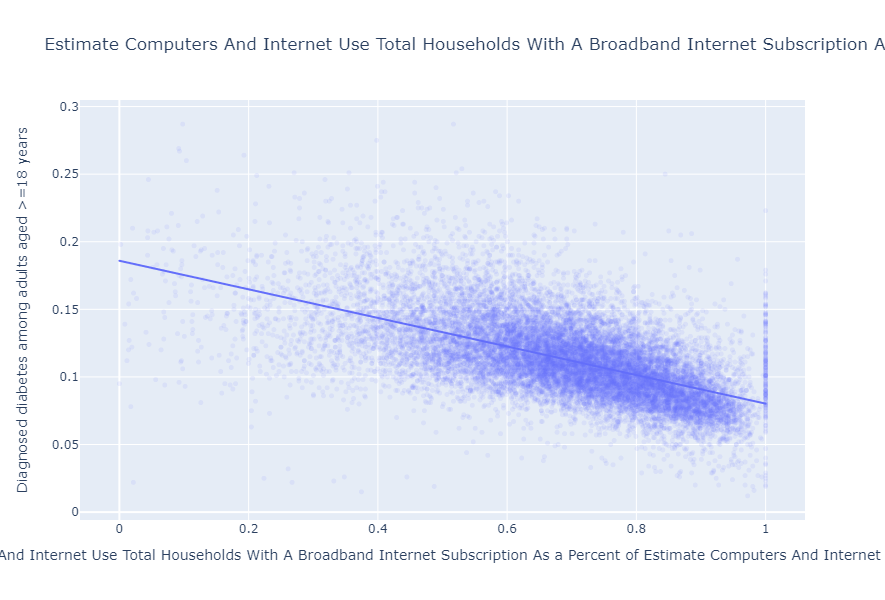

In [63]:
get_plot(0, 0, X_train_initial, y_train, lambda x: x**2)

In [59]:
def get_plot_with_residuals(x_idx, y_idx, X_df, y_df, transformation=lambda x: x):
    x_feature = X_df.columns[x_idx]
    y_feature = y_df.columns[y_idx]
    
    # Create the scatter plot for the original data
    fig = px.scatter(
        x=transformation(X_df.iloc[:, x_idx]),
        y=y_df.iloc[:, y_idx],
        title=f"{x_feature} vs {y_feature}",
    )

    # Add the residuals as a new trace
    residuals = y_df.iloc[:, y_idx] - transformation(X_df.iloc[:, x_idx])
    fig.add_trace(
        px.scatter(
            x=transformation(X_df.iloc[:, x_idx]),
            y=residuals,
        ).data[0]
    )

    fig.update_traces(marker=dict(size=5, opacity=0.1))
    fig.update_layout(height=600)
    fig.update_yaxes(title_text=y_feature)
    fig.update_xaxes(title_text=x_feature)
    
    fig.show()

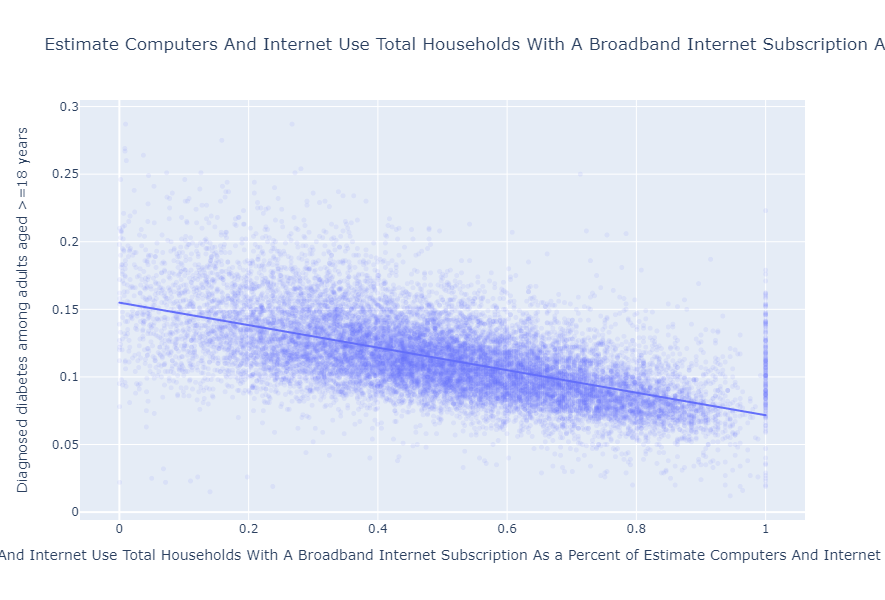

In [67]:
get_plot(0, 0, X_train_initial, y_train, lambda x: x**4)

In [95]:
from sklearn.linear_model import LinearRegression
def get_residuals(x_idx, y_idx, X_df, y_df, transformation=lambda x: x, l="normal", y_transformation=lambda x: x):
    model = LinearRegression()
    x_feature = X_df.columns[x_idx]
    y_feature = y_df.columns[y_idx]
    x_col = transformation(X_df[[x_feature]])
    y_col = y_transformation(y_df[y_feature])
    model.fit(x_col, y_col)
    predicted_y = model.predict(x_col)
    residuals = y_col - predicted_y
    test_fig = px.scatter(
        x=transformation(X_df.iloc[:, x_idx]),
        y=residuals,
        title = f"{x_feature} vs {y_feature} Residuals {l}",
        trendline="ols"
       )

    test_fig.update_traces(marker=dict(size=5, opacity=0.1))
    test_fig.update_layout(height=600)
    test_fig.update_yaxes(title_text=y_feature)
    test_fig.update_xaxes(title_text=x_feature)
    test_fig.show()

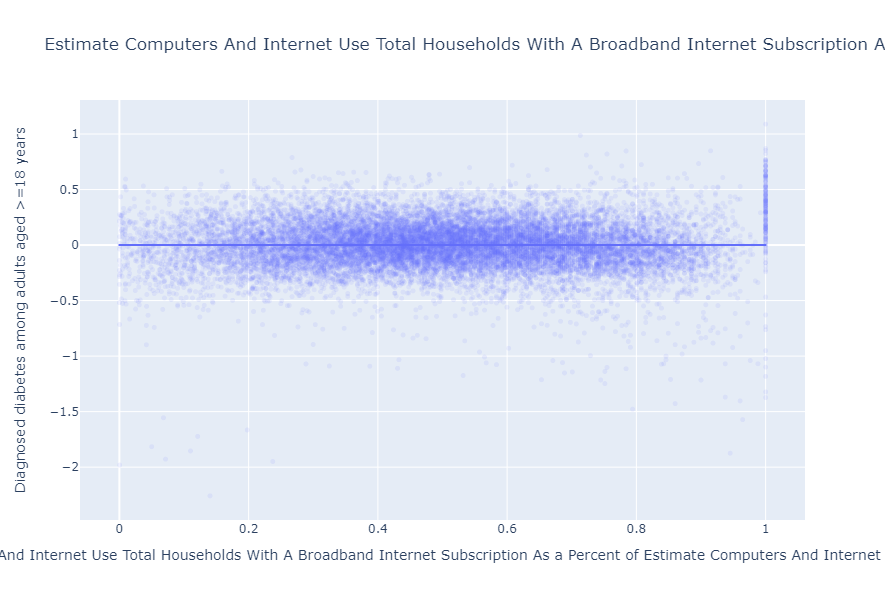

In [101]:
get_residuals(0, 0, X_train_initial, y_train, lambda x: x**4, "To the fourth", lambda y: np.log(y))

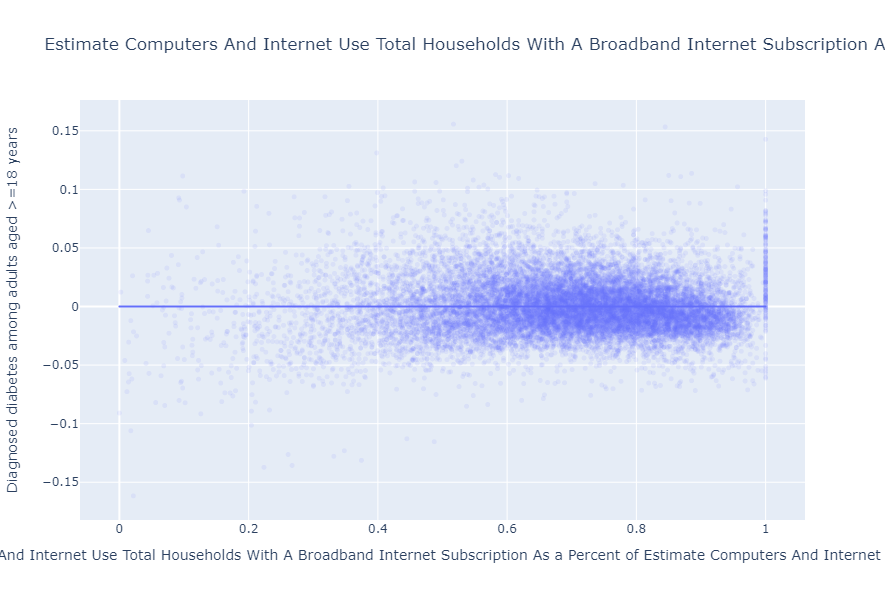

In [97]:
get_residuals(0, 0, X_train_initial, y_train, lambda x: x**2, "Squared")

In [75]:
X_train_initial["Broadband Internet (%) squared"] = X_train_initial.iloc[:, 0] ** 2
X_train_initial["Broadband Internet (%) cubed"] = X_train_initial.iloc[:, 0] ** 3
X_train_initial["Broadband Internet (%) to the fourth"] = X_train_initial.iloc[:, 0] ** 4
X_train_initial

C:\Users\na933\AppData\Local\Temp\ipykernel_24756\1102088147.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\na933\AppData\Local\Temp\ipykernel_24756\1102088147.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\na933\AppData\Local\Temp\ipykernel_24756\1102088147.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

,Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households,STATE_AK,STATE_AL,STATE_AR,STATE_AZ,STATE_CA,STATE_CO,STATE_CT,STATE_DC,STATE_DE,...,STATE_UT,STATE_VA,STATE_VT,STATE_WA,STATE_WI,STATE_WV,Bias,Broadband Internet (%) squared,Broadband Internet (%) cubed,Broadband Internet (%) to the fourth
ZCTA,,,,,,,,,,,,,,,,,,,,,
20106,0.896,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1,0.802816,0.719323,0.644514
70083,0.788,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,0.620944,0.489304,0.385571
18221,0.651,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,0.423801,0.275894,0.179607
97735,0.262,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,0.068644,0.017985,0.004712
42170,0.826,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,0.682276,0.563560,0.465501
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72046,0.712,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,0.506944,0.360944,0.256992
72076,0.796,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,0.633616,0.504358,0.401469
56340,0.790,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,0.624100,0.493039,0.389501


<h2>Training the initial model - broadband internet + states vs diabetes</h2>

In [77]:
initial_model_diabetes = LinearRegression()
initial_model_diabetes.fit(X_train_initial.drop(columns=[
    "Broadband Internet (%) squared",
    "Broadband Internet (%) cubed",
    "Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households"
]), y_train.iloc[:, 0])

LinearRegression()

In [79]:
predicted_initial_model_diabetes_y = initial_model_diabetes.predict(X_train_initial.drop(columns=[
    "Broadband Internet (%) squared",
    "Broadband Internet (%) cubed",
    "Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households"
]))

In [80]:
predicted_initial_model_diabetes_y

array([0.10697965, 0.13494202, 0.1257472 , ..., 0.10691947, 0.13037373,
       0.11077389])

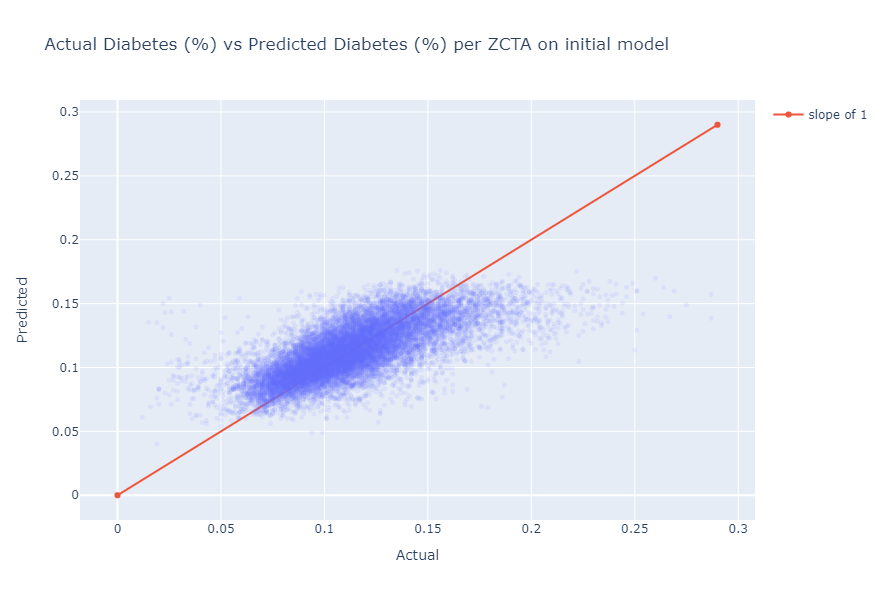

In [92]:
import plotly.graph_objects as go
fig = px.scatter(x=y_train.iloc[:, 0], y=predicted_initial_model_diabetes_y, title="Actual Diabetes (%) vs Predicted Diabetes (%) per ZCTA on initial model")
fig.update_yaxes(title_text="Predicted")
fig.update_xaxes(title_text="Actual")
fig.update_traces(marker=dict(size=5, opacity=0.1))
fig.add_trace(go.Scatter(x=[0, 0.29], y=[0, 0.29], name="slope of 1", line_shape='linear'))
fig.update_layout(height=600)
fig.show()

In [93]:
def rmse(predicted, actual):
    return np.sqrt(np.mean((actual - predicted) ** 2))
rmse(predicted_initial_model_diabetes_y, y_train.iloc[:, 0])

0.020925752863609676

In [102]:
initial_model_diabetes_attempt_2 = LinearRegression()
initial_model_diabetes_attempt_2.fit(X_train_initial.drop(columns=[
    "Broadband Internet (%) squared",
    "Broadband Internet (%) cubed",
    "Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households"
]), np.log(y_train.iloc[:, 0]))

LinearRegression()

In [103]:
predicted_initial_model_diabetes_y_attempt_2 = initial_model_diabetes_attempt_2.predict(X_train_initial.drop(columns=[
    "Broadband Internet (%) squared",
    "Broadband Internet (%) cubed",
    "Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households"
]))

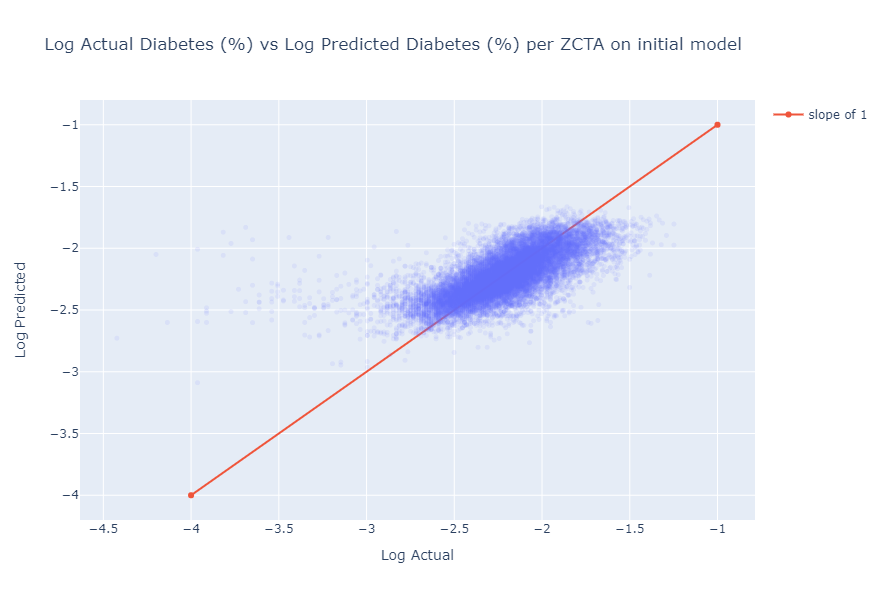

In [105]:
import plotly.graph_objects as go
fig = px.scatter(x=np.log(y_train.iloc[:, 0]), y=predicted_initial_model_diabetes_y_attempt_2, title="Log Actual Diabetes (%) vs Log Predicted Diabetes (%) per ZCTA on initial model")
fig.update_yaxes(title_text="Log Predicted")
fig.update_xaxes(title_text="Log Actual")
fig.update_traces(marker=dict(size=5, opacity=0.1))
fig.add_trace(go.Scatter(x=[-4, -1], y=[-4, -1], name="slope of 1", line_shape='linear'))
fig.update_layout(height=600)
fig.show()

In [106]:
rmse(predicted_initial_model_diabetes_y_attempt_2, np.log(y_train.iloc[:, 0]))

0.19295155246938678

In [111]:
y_train.iloc[:, 0].name

'Diagnosed diabetes among adults aged >=18 years'

In [122]:
# PROCESS
# Plotted broadband vs diabetes initial
# Figured out transformation for broadband and diabetes
# Plotted residuals against each other with fit line of 1 (figure out better way)
# Calculated RMSE

# WHAT THIS FUNCTION DOES
# Given an X DataFrame and a y actual, will train the model, and then return a plot that has the predicted vs actual and RMSE
def assess_model(X, y, y_transformation=lambda x: x, y_transformation_name=""):
    model = LinearRegression()
    y_transformed = y_transformation(y)
    model.fit(X, y_transformed)
    predicted = model.predict(X)
    
    fig = px.scatter(x=y_transformed, y=predicted, title=f"Predicted {y.name} {y_transformation_name} vs. Actual {y.name} {y_transformation_name}")
    fig.update_yaxes(title_text=f"Predicted {y.name} {y_transformation_name}")
    fig.update_xaxes(title_text=f"Actual {y.name} {y_transformation_name}")
    fig.update_traces(marker=dict(size=5, opacity=0.1))
    fig.update_layout(height=600)
    fig.show()
    print(f"RMSE: {rmse(y_transformed, predicted)}")
    return model

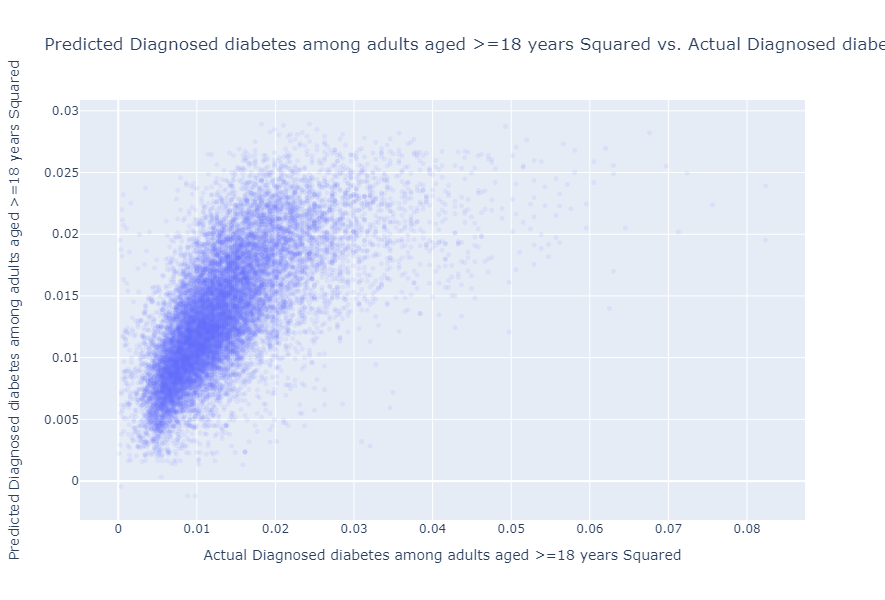

RMSE: 0.005512055979601269


LinearRegression()

In [142]:
X_attempt_2 = X_train_initial.drop(columns=[
    "Broadband Internet (%) squared",
    "Broadband Internet (%) cubed",
    "Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households"
])
assess_model(X_attempt_2, y_train.iloc[:, 0], lambda y: y**2, "Squared")

In [124]:
y_train

,Diagnosed diabetes among adults aged >=18 years,Mental health not good for >=14 days among adults aged >=18 years,Stroke among adults aged >=18 years
ZCTA,,,
20106,0.101,0.144,0.029
70083,0.185,0.215,0.052
18221,0.125,0.158,0.040
97735,0.148,0.165,0.048
42170,0.114,0.162,0.033
...,...,...,...
72046,0.144,0.194,0.045
72076,0.115,0.193,0.034
56340,0.085,0.144,0.027


In [125]:
y_mental_health = y_train["Mental health not good for >=14 days among adults aged >=18 years"]
y_stroke = y_train["Stroke among adults aged >=18 years"]

In [133]:
def get_residuals(x_idx, y_feature, X_df, transformation=lambda x: x, l="", y_transformation=lambda x: x):
    model = LinearRegression()
    x_feature = X_df.columns[x_idx]
    x_col = transformation(X_df[[x_feature]])
    y_col = y_transformation(y_feature)
    model.fit(x_col, y_col)
    predicted_y = model.predict(x_col)
    residuals = y_col - predicted_y
    test_fig = px.scatter(
        x=transformation(X_df.iloc[:, x_idx]),
        y=residuals,
        title = f"{x_feature} vs {y_feature.name} Residuals {l}",
        trendline="ols"
       )

    test_fig.update_traces(marker=dict(size=5, opacity=0.1))
    test_fig.update_layout(height=600)
    test_fig.update_yaxes(title_text=y_feature.name)
    test_fig.update_xaxes(title_text=x_feature)
    test_fig.show()
    
def get_plot(x_idx, y_feature, X_df, transformation=lambda x: x, transformation_name=""):
    x_feature = X_df.columns[x_idx]
    test_fig = px.scatter(
        x=transformation(X_df.iloc[:, x_idx]),
        y=y_feature,
        title = f"{x_feature} {transformation_name} vs {y_feature.name}",
        trendline="ols"
       )

    test_fig.update_traces(marker=dict(size=5, opacity=0.1))
    test_fig.update_layout(height=600)
    test_fig.update_yaxes(title_text=y_feature.name)
    test_fig.update_xaxes(title_text=f"{x_feature} {transformation_name}")
    test_fig.show()
    
def assess_model(X, y, y_transformation=lambda x: x, y_transformation_name=""):
    model = LinearRegression()
    y_transformed = y_transformation(y)
    model.fit(X, y_transformed)
    predicted = model.predict(X)
    
    fig = px.scatter(x=y_transformed, y=predicted, title=f"Predicted {y.name} {y_transformation_name} vs. Actual {y.name} {y_transformation_name}")
    fig.update_yaxes(title_text=f"Predicted {y.name} {y_transformation_name}")
    fig.update_xaxes(title_text=f"Actual {y.name} {y_transformation_name}")
    fig.update_traces(marker=dict(size=5, opacity=0.1))
    fig.update_layout(height=600)
    fig.show()
    print(f"RMSE: {rmse(y_transformed, predicted)}")
    return model

def rmse(predicted, actual):
    return np.sqrt(np.mean((actual - predicted) ** 2))

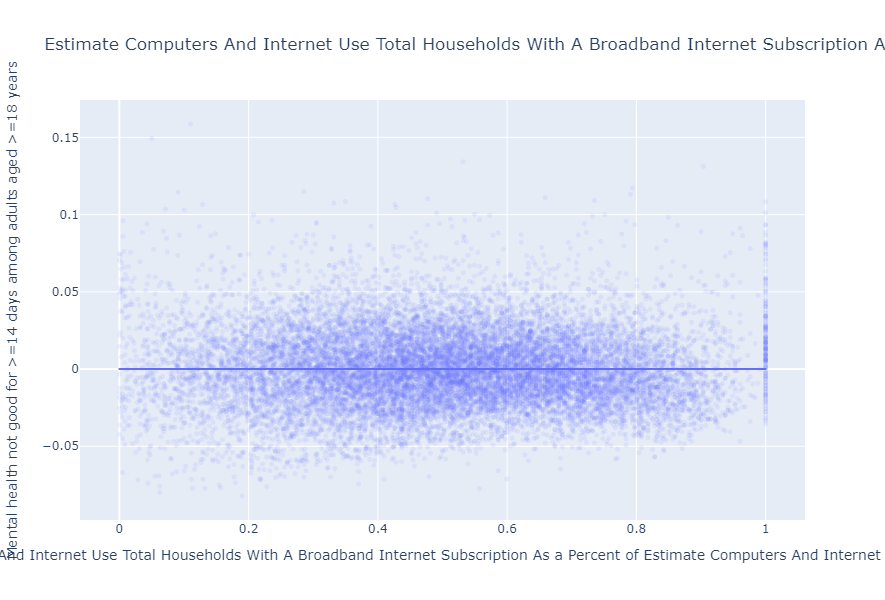

In [140]:
get_residuals(0, y_mental_health, X_train_initial, lambda x: x**4, "To the fourth")

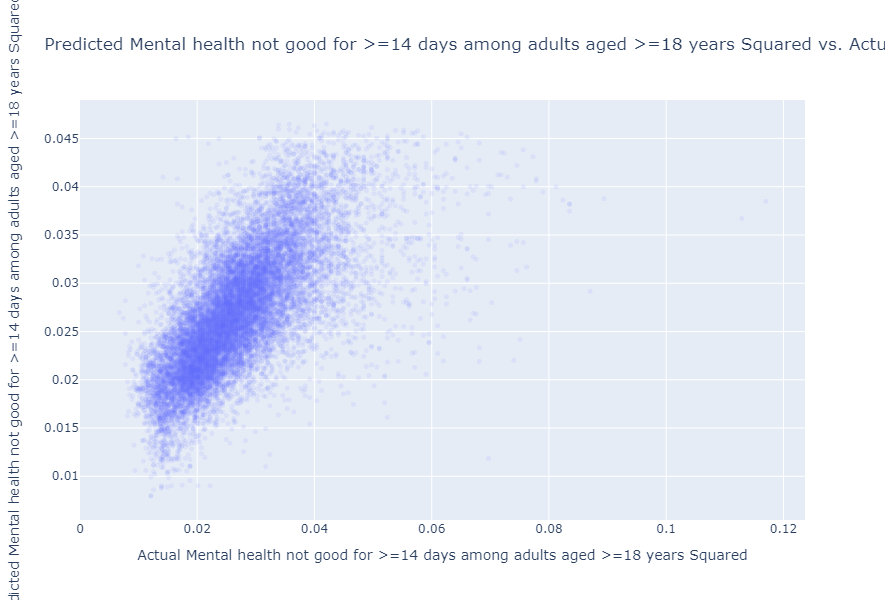

RMSE: 0.0067595568704989124


LinearRegression()

In [141]:
initial_design_matrix_mental_health = X_train_initial.drop(columns=[
    "Broadband Internet (%) squared",
    "Broadband Internet (%) cubed",
    "Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households"
])
assess_model(initial_design_matrix_mental_health, y_mental_health, lambda y: y**2, "Squared")

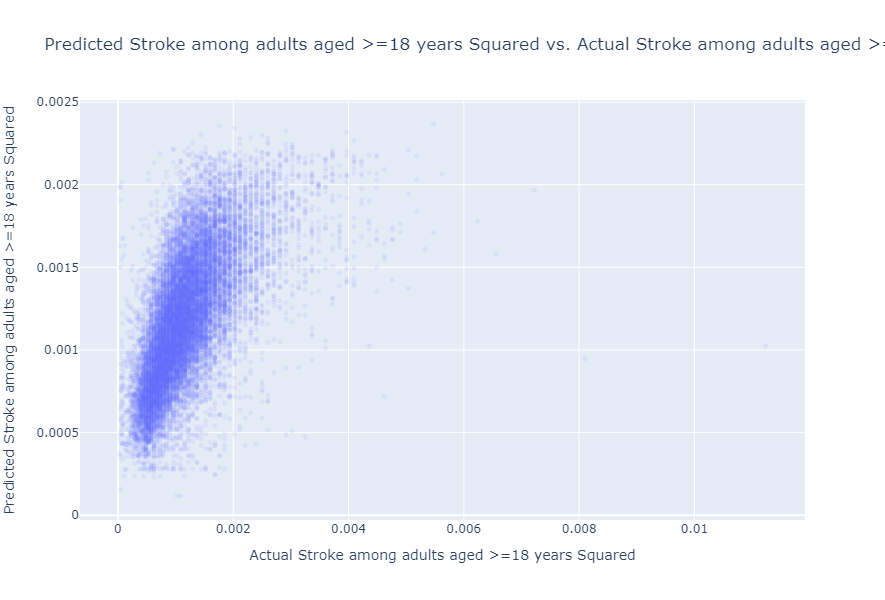

RMSE: 0.0004888674507805933


LinearRegression()

In [151]:
initial_design_matrix_stroke = X_train_initial.drop(columns=[
    "Broadband Internet (%) squared",
    "Broadband Internet (%) cubed",
    "Estimate Computers And Internet Use Total Households With A Broadband Internet Subscription As a Percent of Estimate Computers And Internet Use Total Households"
])
assess_model(initial_design_matrix_stroke, y_stroke, lambda y: y**2, "Squared")